<a href="https://colab.research.google.com/github/kenzaCodeHub/Analyse-de-l-expression-motionnelle-dans-les-images-et-les-textes/blob/main/calibration.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import cv2
import glob
import os
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


✅ Image générée : /content/drive/MyDrive/calibration (1)/resultat_detection_coins.jpg
C'est celle-ci qu'il faut mettre au début de votre rapport !


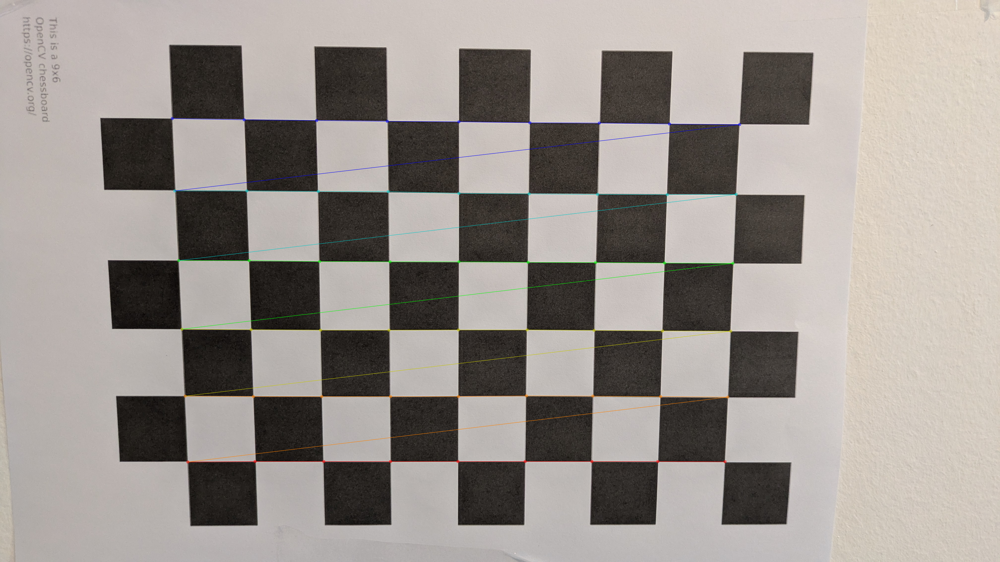

In [ ]:
path_dossier = "/content/drive/MyDrive/calibration (1)"

dims_damier = (9, 6)  # nb de coins internes (colonnes, lignes)

# Affichage dans Colab (cv2.imshow ne marche pas)
from google.colab.patches import cv2_imshow

def imread_robuste(fname):
    # robuste (accents / unicode) : lecture binaire + imdecode
    with open(fname, "rb") as f:
        data = np.frombuffer(f.read(), dtype=np.uint8)
    return cv2.imdecode(data, cv2.IMREAD_COLOR)

# Chercher des images
pattern = os.path.join(path_dossier, "*.jpg")
images = sorted(glob.glob(pattern))

if len(images) > 0:
    for fname in images:
        try:
            img = imread_robuste(fname)
        except:
            continue

        if img is None:
            continue

        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

        ret, corners = cv2.findChessboardCorners(gray, dims_damier, None)

        if ret:
            cv2.drawChessboardCorners(img, dims_damier, corners, ret)

            nom_sortie = os.path.join(path_dossier, "resultat_detection_coins.jpg")
            ok = cv2.imwrite(nom_sortie, img)

            if ok:
                print(f"✅ Image générée : {nom_sortie}")
                print("C'est celle-ci qu'il faut mettre au début de votre rapport !")
            else:
                print("❌ Échec de sauvegarde (chemin non accessible/permissions).")

            # Afficher dans le notebook
            cv2_imshow(img)
            break
    else:
        print("❌ Aucune image n'a permis de détecter le damier.")
else:
    print("❌ Pas d'images trouvées (.jpg) dans :", path_dossier)


✅ Images utilisables pour calibration : 29

--- Résultats calibration ---
RMS: 2.01911233394482
Matrice intrinsèque K:
 [[3.02438425e+03 0.00000000e+00 2.01833701e+03]
 [0.00000000e+00 3.02107919e+03 1.08598296e+03]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
Distorsion:
 [ 1.51459478e-01 -1.01654334e+00 -3.00504485e-04 -4.65043405e-04
  2.11794868e+00]
Erreur reprojection moyenne: 0.26466668827174333
✅ Image undistort sauvegardée : /content/drive/MyDrive/calibration (1)/resultat_undistort.jpg


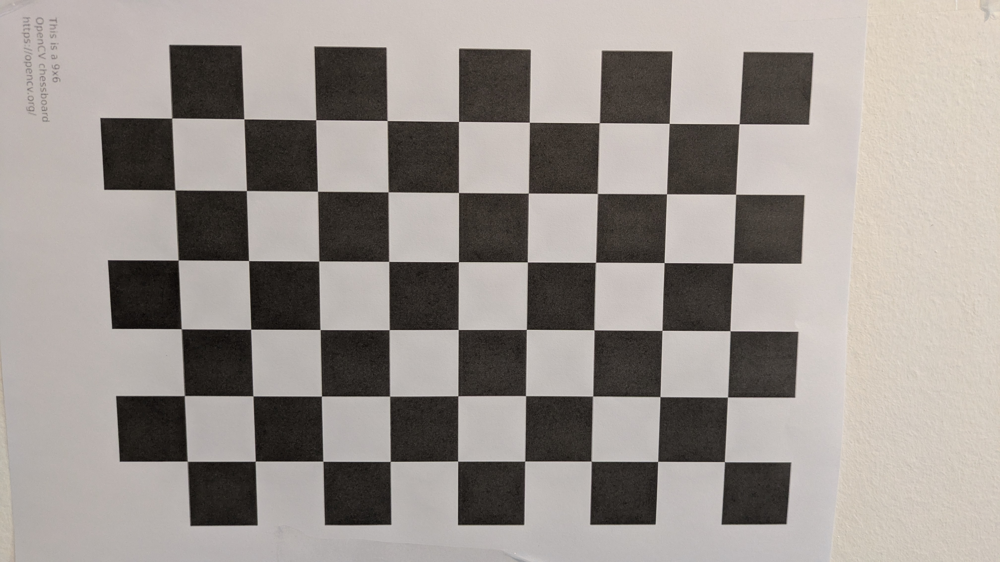

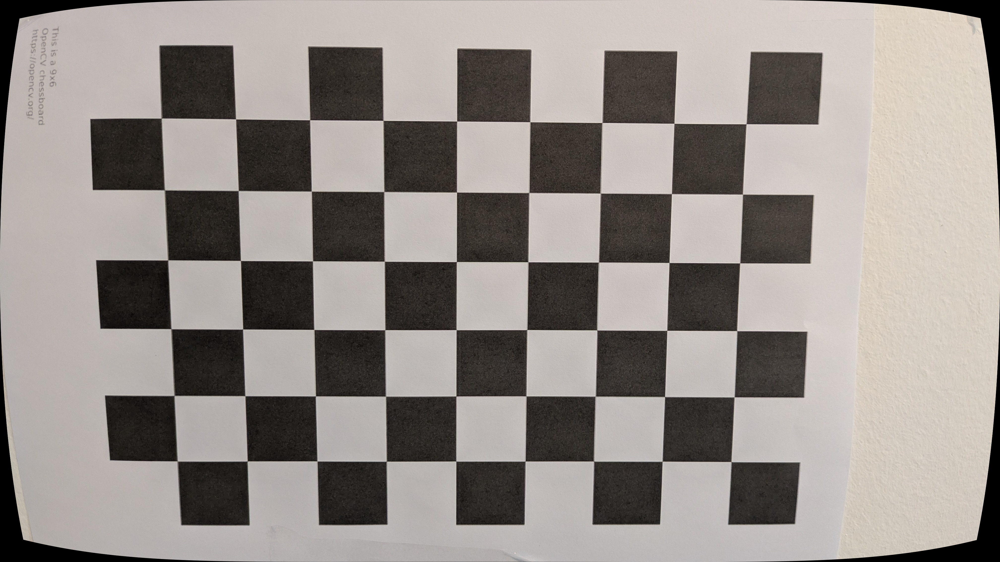

In [ ]:
#  PARAMÈTRE IMPORTANT :
taille_carre = 0.025

# Préparer les points 3D du damier (dans le repère du damier, Z=0)
objp = np.zeros((dims_damier[0]*dims_damier[1], 3), np.float32)
objp[:, :2] = np.mgrid[0:dims_damier[0], 0:dims_damier[1]].T.reshape(-1, 2)
objp *= taille_carre

objpoints = []  # points 3D (monde)
imgpoints = []  # points 2D (image)

criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 1e-3)

image_size = None
nb_ok = 0

for fname in images:
    img = imread_robuste(fname)
    if img is None:
        continue

    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    image_size = gray.shape[::-1]  # (width, height)

    ret, corners = cv2.findChessboardCorners(gray, dims_damier, None)
    if not ret:
        continue

    # Raffinage sub-pixel
    corners2 = cv2.cornerSubPix(gray, corners, (11,11), (-1,-1), criteria)

    objpoints.append(objp)
    imgpoints.append(corners2)
    nb_ok += 1

print("✅ Images utilisables pour calibration :", nb_ok)

# Calibration (nécessite au moins quelques images)
if nb_ok >= 5:
    rms, K, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, image_size, None, None)
    print("\n--- Résultats calibration ---")
    print("RMS:", rms)
    print("Matrice intrinsèque K:\n", K)
    print("Distorsion:\n", dist.ravel())

    # Erreur de reprojection moyenne
    total_error = 0
    for i in range(len(objpoints)):
        imgpoints2, _ = cv2.projectPoints(objpoints[i], rvecs[i], tvecs[i], K, dist)
        error = cv2.norm(imgpoints[i], imgpoints2, cv2.NORM_L2) / len(imgpoints2)
        total_error += error
    mean_error = total_error / len(objpoints)
    print("Erreur reprojection moyenne:", mean_error)

    # Démonstration undistort sur la première image
    img0 = imread_robuste(images[0])
    h, w = img0.shape[:2]
    newK, roi = cv2.getOptimalNewCameraMatrix(K, dist, (w,h), 1, (w,h))
    undist = cv2.undistort(img0, K, dist, None, newK)

    nom_undist = os.path.join(path_dossier, "resultat_undistort.jpg")
    cv2.imwrite(nom_undist, undist)
    print("✅ Image undistort sauvegardée :", nom_undist)

    cv2_imshow(img0)
    cv2_imshow(undist)

else:
    print("❌ Pas assez d'images détectées (il en faut au moins ~5, idéalement 10-20).")
